In [112]:
import pandas as pd
from sklearn.preprocessing import OrdinalEncoder
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict
from catboost import CatBoostRegressor, CatBoostClassifier
import numpy as np
from math import sqrt
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn import metrics
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2 , f_classif
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import SGDRegressor
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.tree import DecisionTreeRegressor
import warnings
warnings.filterwarnings("ignore")
plt.style.use('fivethirtyeight')
from sklearn.metrics import mean_squared_error, r2_score 
from sklearn.metrics import mean_poisson_deviance, mean_gamma_deviance, accuracy_score
from sklearn.preprocessing import MinMaxScaler
from itertools import cycle
from sklearn.model_selection import GridSearchCV


In [113]:
df = pd.read_csv('new.csv')
df.drop('Unnamed: 0', 1 , inplace=True)
#df = df.drop(df[(df['Charge']>6)].index).reset_index(drop=True)
df

,Service,ConNo,Charge,out,in,id,LineOp,totality,code,type,length,stop,td,iy,oy
0,Import Demurrage charges,TCNU5562346,30,2017-01-11 07:08:24.650,2017-01-02 19:02:21.587,231452,MOL,FULL,45G0,HC,40,NaN,8,2017,2017
1,Import Demurrage charges,TCNU7735815,5,2017-01-12 08:01:42.930,2017-01-02 04:15:35.750,231455,MOL,FULL,45G0,HC,40,NaN,10,2017,2017
2,Import Demurrage charges,TEMU7416340,5,2017-01-12 08:01:42.930,2017-01-02 14:54:18.797,231458,MOL,FULL,45G0,HC,40,NaN,9,2017,2017
3,Import Demurrage charges,APHU6237948,30,2017-01-17 13:49:28.337,2017-01-02 16:54:20.587,231466,APL,FULL,45G0,HC,40,NaN,14,2017,2017
4,Import Demurrage charges,APHU6244361,15,2017-01-14 14:29:34.250,2017-01-02 13:50:08.797,231467,APL,FULL,45G0,HC,40,NaN,12,2017,2017
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
189935,Import Demurrage charges,MEDU9683390,18,2022-06-02 07:08:12.750,2022-06-01 13:42:00.700,1715123,MSC,FULL,45R1,RF,40,NaN,0,2022,2022
189936,Import Demurrage charges,MEDU9745379,18,2022-06-02 08:47:22.907,2022-06-01 13:36:19.103,1715124,MSC,FULL,45R1,HR,40,NaN,0,2022,2022
189937,Import Demurrage charges,MEDU9740490,18,2022-06-02 07:08:12.750,2022-06-01 13:48:52.953,1715128,MSC,FULL,45R1,HR,40,NaN,0,2022,2022
189938,Import Demurrage charges,MNBU3259581,18,2022-06-02 11:46:25.273,2022-06-01 20:43:04.007,1715660,MSK,FULL,45R1,HR,40,NaN,0,2022,2022


In [114]:
df.drop(['Service', 'ConNo', 'out', 'in', 'id', 'stop', 'totality', 'LineOp'], 1 , inplace=True)

In [115]:
y=df['Charge']
X=df.drop('Charge',axis=1)
cols=X.columns
cols
#Splitting data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=44, shuffle =True)


# Defining function For ML models

In [14]:
def predict(ml_model):          
    model=ml_model.fit(X_train,y_train)
    print('Training score : {}'.format(model.score(X_train,y_train)))
    y_prediction=model.predict(X_test)
    print('predictions are: \n {}'.format(y_prediction[:10]))
    print('\n')
    r2_score=metrics.r2_score(y_test,y_prediction)
    print('r2 score: {}'.format(r2_score))
    print('MAE:',metrics.mean_absolute_error(y_test,y_prediction))
    print('MSE:',metrics.mean_squared_error(y_test,y_prediction))
    print('RMSE:',np.sqrt(metrics.mean_squared_error(y_test,y_prediction)))
    sns.distplot(y_test-y_prediction)



# Random Forest Algorithm

In [ ]:
predict(RandomForestRegressor(ccp_alpha=0.1,n_estimators=50, max_depth = 70))

# Gradient Boosting

In [ ]:
predict(GradientBoostingRegressor(alpha=.9 , n_estimators=12,learning_rate=0.5, max_depth=12))

# Linear Regression Algorithm

In [ ]:
predict(LinearRegression())

# Lasso Algorithm

In [ ]:
predict(Lasso(max_iter=20,alpha=2))

# Ridge Algorithm

In [ ]:
predict(Ridge(solver='auto',alpha=0.5,  max_iter=12))

# K-Neighbors Algorithm

In [ ]:
predict(KNeighborsRegressor(n_neighbors=3,
   
    weights='distance',
    algorithm='ball_tree',
    leaf_size=40,
    p=4,
    metric='minkowski',
    metric_params=None,
    n_jobs=None,))

# Decision Tree Algorithm

In [ ]:
predict(DecisionTreeRegressor(max_depth=25,random_state=33))

# Cat Boost Regressor

In [ ]:
predict(CatBoostRegressor(verbose=False,
                         loss_function='RMSE',
                         learning_rate= 0.1,
                         cat_features = ['type', 'LineOp', 'code'], 
                         random_strength=0.4,
                         bagging_temperature=2,
                         eval_metric='MSLE',
                         random_seed=42,
                         l2_leaf_reg=40,
                         max_depth=10,
                         model_size_reg=5,
                         n_estimators=1000,
                         bootstrap_type='Bayesian',
                         grow_policy='Lossguide',
                         min_data_in_leaf=10,
                         one_hot_max_size=4,
                         score_function='L2'))

# Super vector regression

In [15]:
predict(SVR(kernel= 'rbf', C= 1e2, gamma= 0.1))

ValueError: could not convert string to float: '45G0'

# Fine Tuning CATBOOSTREGRESSOR

In [ ]:
from catboost import CatBoostRegressor
columns_to_keep = ['td', 'length', 'type', 'code', 'LineOp', 'Charge']
var_dict = {}
var_dict["independant"] = ['td', 'length', 'type', 'code', 'LineOp']
cat_features = ['type', 'LineOp', 'code']
var_dict["dependant"]   = ["Charge"]
features_to_keep = df[columns_to_keep]
features_to_keep[cat_features] = features_to_keep[cat_features].astype(str)
features_to_keep.dropna(inplace =  True)  ## this cannot be done in test becauase we need all the 20K samples
params = {"cat_features": cat_features, "loss_function": "RMSE", "iterations" : 100}
#cat_model = catboost_regressor.new_instance(params)
#rf_model_output = cat_model.model_run(features_to_keep, var_dict, )

In [ ]:
model_CBR = CatBoostRegressor()

parameters = {"cat_features": cat_features, "loss_function": ['RMSE'], 
          "random_seed" : [42],
#           "iterations" : 100, 
          "verbose":[False],
         'learning_rate': [0.05, 0.1, 0.2],
#          'depth': 8,   ##depth of the trees
         'l2_leaf_reg': [40], 
         "max_depth" : [10],  #max depth /depth of 10 makes sense 
         "model_size_reg" : [5],
         "n_estimators": [1000],
         "random_strength": [0.4],  #We use randomness when scoring the splits. Every split gets a score and then we add some randomness to it, this helps to reduce overfitting.
#          "bootstrap_type " :"Bayesian",
          "bagging_temperature": [2],    # 0 to +infty  / Only with Bayesian bootstraping
          "eval_metric" : ["MSLE"] , #The metric used for overfitting detection 
          "grow_policy": ["Lossguide"] , # The tree growing policy. Defines how to perform greedy tree construction.
        "min_data_in_leaf" :  [10],  # The minimum number of training samples in a leaf. CatBoost does not search for new splits in leaves with samples count less than the specified value.
                              # Can be used only with the Lossguide and Depthwise growing policies.
        "one_hot_max_size": [4], # Use one-hot encoding for all categorical features with a number of different values less than or equal to the given parameter value. Ctrs are not calculated for such features.
         "score_function":["L2"]
         }

grid = GridSearchCV(estimator=model_CBR, param_grid = parameters, cv = 2, n_jobs=-1)
grid.fit(X_train, y_train)

In [ ]:
print(" Results from Grid Search " )
print("\n The best estimator across ALL searched params:\n", grid.best_estimator_)
print("\n The best score across ALL searched params:\n", grid.best_score_)
print("\n The best parameters across ALL searched params:\n", grid.best_params_)

In [116]:
catbr = CatBoostRegressor(verbose=False,
                         loss_function='RMSE',
                         learning_rate= 0.1,
                        #cat_features = ['type', 'LineOp', 'code'], 
                         random_strength=0.4,
                         bagging_temperature=2,
                         eval_metric='MSLE',
                         random_seed=42,
                         l2_leaf_reg=40,
                         max_depth=10,
                         model_size_reg=5,
                         n_estimators=1000,
                         bootstrap_type='Bayesian',
                         grow_policy='Lossguide',
                         min_data_in_leaf=10,
                         one_hot_max_size=4,
                         score_function='L2').fit(X_train,
                                                    y_train,
                                                    plot=True,
                                                    eval_set=(X_test, y_test),
                                                    use_best_model=True,
                                                    cat_features = ['type', 'code'])

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [117]:
X_test

,code,type,length,td,iy,oy
50142,45G0,HC,40,9,2018,2018
76864,45R1,HR,40,0,2018,2018
153877,45G0,HC,40,10,2020,2020
165545,22G0,DC,20,10,2021,2021
73119,45R1,RF,40,4,2018,2018
...,...,...,...,...,...,...
102190,45R1,HR,40,5,2019,2019
116289,22G0,DC,20,9,2019,2019
28353,45G0,HC,40,11,2017,2017
102591,45G0,HC,40,20,2019,2019


In [118]:
yPred = catbr.predict(['22G0', 'DC', 20, 9, 2022, 2022])
print(str(round(yPred))+' KWD')
print(str(yPred)+' KWD')

3 KWD
3.2649659215156532 KWD


In [124]:
yPred = catbr.predict(X_test)

In [123]:
fig = px.scatter(y=yPred,x=y_test, labels={"x": "True (KWD)","y": "Predicted (KWD)"})
fig.show()

In [121]:
tr = "{:,}".format(sum(y_test))
pr = "{:,}".format(round(sum(yPred), 3))
ax = "{:,}".format(round((((abs(sum(y_test)-sum(yPred)))/sum(y_test))*100), 2))



print(" Results from CatBoostRegressor " )
print("\n True Revenue is:\n", tr)
print("\n AI Regression Result: \n", pr)
print("\n AI System is: " + ax + "% off")

 Results from CatBoostRegressor 

 True Revenue is:
 2,266,415

 AI Regression Result: 
 2,267,654.504

 AI System is: 0.05% off


In [111]:
df['Charge'].describe()

count    189940.000000
mean         35.928067
std          71.918035
min           3.000000
25%           9.000000
50%          18.000000
75%          40.000000
max        4980.000000
Name: Charge, dtype: float64

Text(0.5, 0, 'CatBoost Feature Importance')

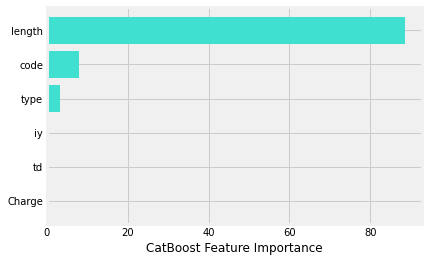

In [107]:
sorted_feature_importance = catbr.feature_importances_.argsort()
plt.barh(df.columns[sorted_feature_importance], 
        catbr.feature_importances_[sorted_feature_importance], 
        color='turquoise')
plt.xlabel("CatBoost Feature Importance")

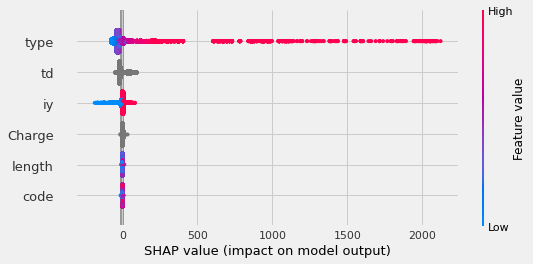

In [111]:
import shap

explainer = shap.TreeExplainer(catbr)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test, feature_names = df.columns[sorted_feature_importance])

In [123]:
df

,Service,ConNo,Charge,out,in,id,LineOp,totality,code,type,length,stop,td,iy,oy
0,Import Demurrage charges,TCNU5562346,30,2017-01-11 07:08:24.650,2017-01-02 19:02:21.587,231452,MOL,FULL,45G0,HC,40,NaN,8,2017,2017
1,Import Demurrage charges,TCNU7735815,5,2017-01-12 08:01:42.930,2017-01-02 04:15:35.750,231455,MOL,FULL,45G0,HC,40,NaN,10,2017,2017
2,Import Demurrage charges,TEMU7416340,5,2017-01-12 08:01:42.930,2017-01-02 14:54:18.797,231458,MOL,FULL,45G0,HC,40,NaN,9,2017,2017
3,Import Demurrage charges,APHU6237948,30,2017-01-17 13:49:28.337,2017-01-02 16:54:20.587,231466,APL,FULL,45G0,HC,40,NaN,14,2017,2017
4,Import Demurrage charges,APHU6244361,15,2017-01-14 14:29:34.250,2017-01-02 13:50:08.797,231467,APL,FULL,45G0,HC,40,NaN,12,2017,2017
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
189935,Import Demurrage charges,MEDU9683390,18,2022-06-02 07:08:12.750,2022-06-01 13:42:00.700,1715123,MSC,FULL,45R1,RF,40,NaN,0,2022,2022
189936,Import Demurrage charges,MEDU9745379,18,2022-06-02 08:47:22.907,2022-06-01 13:36:19.103,1715124,MSC,FULL,45R1,HR,40,NaN,0,2022,2022
189937,Import Demurrage charges,MEDU9740490,18,2022-06-02 07:08:12.750,2022-06-01 13:48:52.953,1715128,MSC,FULL,45R1,HR,40,NaN,0,2022,2022
189938,Import Demurrage charges,MNBU3259581,18,2022-06-02 11:46:25.273,2022-06-01 20:43:04.007,1715660,MSK,FULL,45R1,HR,40,NaN,0,2022,2022


In [126]:
fig = px.scatter(df, x="td", y="Charge", color='type', hover_data=['id', 'iy', 'ConNo', 'LineOp', 'code', 'length'])
fig.show()